In [1]:
import numpy as np
from tqdm import tqdm
import anndata as ad
import sys
import matplotlib.pyplot as plt
import scanpy as sc
from scipy.io import savemat, loadmat
import os
import pandas as pd

In [2]:
sys.path.append("..")

from util.dspin_abstract_jl import DSPIN

/Users/ygong/git/DSPIN-abstract/test/../util/compute_new.py:198: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


In [48]:
from util.plotting import format_label

ImportError: cannot import name 'format_label' from 'util.plotting' (/Users/ygong/git/DSPIN-abstract/test/../util/plotting.py)

In [90]:
from importlib import reload
import util.plotting
reload(util.plotting)
from util.plotting import plot_final

In [3]:
data_folder = '../data/thomsonlab_signaling/'
large_data_folder = '../large_data/thomsonlab_signaling/'

In [4]:
print(os.getcwd())

/Users/ygong/git/DSPIN-abstract/test


In [6]:
cadata = ad.read_h5ad(large_data_folder + 'thomsonlab_signaling_filtered_2500_scvi_umap.h5ad')

/Users/ygong/anaconda3/envs/be206/lib/python3.11/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [7]:
cell_select = np.random.choice(cadata.shape[0], 10000, replace=False)
gene_select = np.random.choice(cadata.shape[1], 500, replace=False)
cadata = cadata[cell_select, :][:, gene_select].copy()
cadata.write(large_data_folder + 'thomsonlab_signaling_filtered_2500_scvi_umap_small.h5ad')

In [4]:
cadata = ad.read_h5ad(large_data_folder + 'thomsonlab_signaling_filtered_2500_scvi_umap_small.h5ad')

save_path = "./test_signalling_0924/"

/Users/ygong/anaconda3/envs/be206/lib/python3.11/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [5]:
samp_list = np.unique(cadata.obs['sample_id'])
subset_list = samp_list[: 3]

In [6]:
subset_list

array(['ALL_CYTO_1', 'ALL_CYTO_2', 'ALPROSTADIL_ALL_CYTO_1'], dtype=object)

In [7]:
num_spin = 10
model = DSPIN(cadata, save_path, num_spin=num_spin)

496 genes have expression in more than 0.02 of the cells
LargeDSPIN initialized.


In [8]:
model.gene_program_discovery(balance_obs='leiden')

Computing ONMF decomposition...
ONMF decomposition 0 already exists. Skipping...
ONMF decomposition 1 already exists. Skipping...
ONMF decomposition 2 already exists. Skipping...
ONMF decomposition 3 already exists. Skipping...
ONMF decomposition 4 already exists. Skipping...
ONMF decomposition 5 already exists. Skipping...
ONMF decomposition 6 already exists. Skipping...
ONMF decomposition 7 already exists. Skipping...
ONMF decomposition 8 already exists. Skipping...
ONMF decomposition 9 already exists. Skipping...


In [9]:
model.network_infer(sample_col_name='sample_id', example_list=subset_list)

Using maximum_likelihood for network inference.
Progress: 5, Network gradient: 2.440059
Progress: 10, Network gradient: 1.259684
Progress: 15, Network gradient: 0.741274
Progress: 20, Network gradient: 0.438252
Progress: 25, Network gradient: 0.277775
Progress: 30, Network gradient: 0.185020
Progress: 35, Network gradient: 0.101779
Progress: 40, Network gradient: 0.058201
Progress: 45, Network gradient: 0.041213
Progress: 50, Network gradient: 0.026700
Progress: 55, Network gradient: 0.013344
Progress: 60, Network gradient: 0.009894
Progress: 65, Network gradient: 0.005754
Progress: 70, Network gradient: 0.002807
Progress: 75, Network gradient: 0.001857
Progress: 80, Network gradient: 0.001257
Progress: 85, Network gradient: 0.000769
Progress: 90, Network gradient: 0.000437
Progress: 95, Network gradient: 0.000223
Progress: 100, Network gradient: 0.000159


In [10]:
j_mat = model.network

In [43]:
from util.plotting import spin_order

In [28]:
spin_order = spin_order(j_mat)

In [25]:
gene_programs = np.arange(0, 10).tolist()

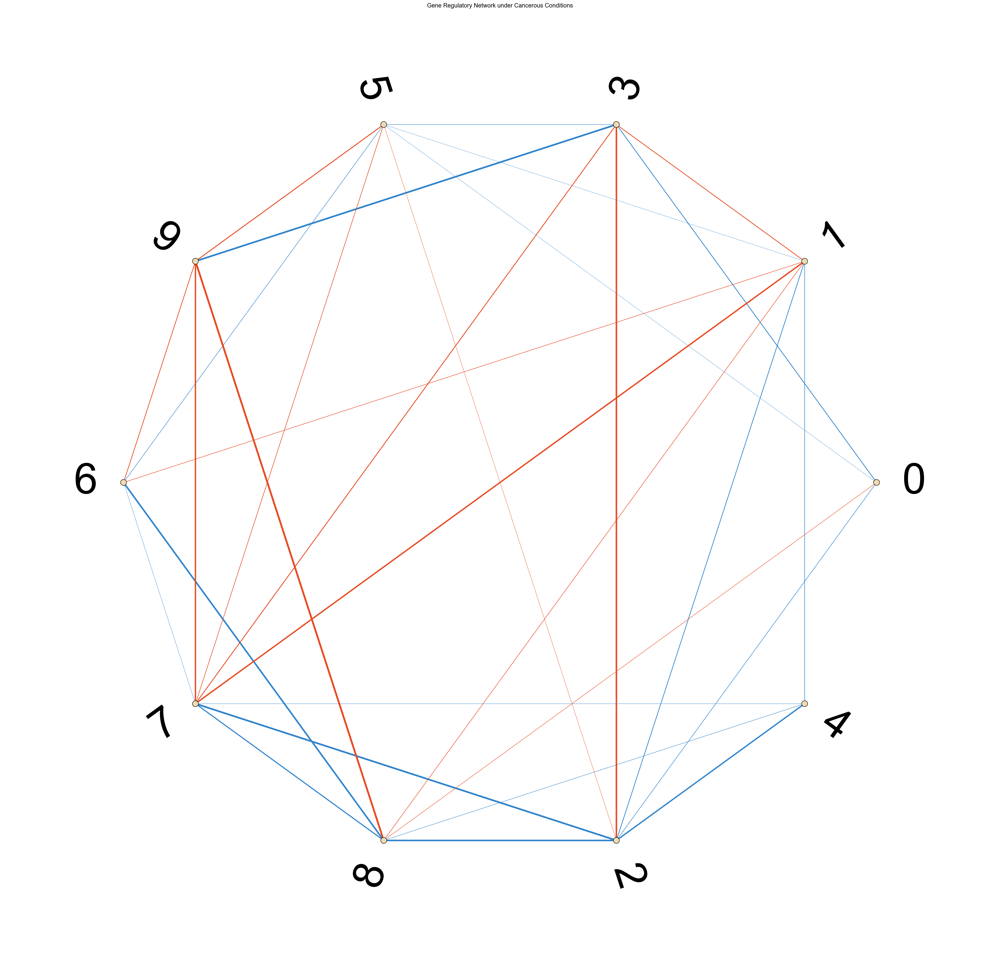

In [35]:
plot_final(num_spin, gene_programs, j_mat, spin_order)

In [37]:
num_spin = 20
model2 = DSPIN(cadata, save_path, num_spin=num_spin)

496 genes have expression in more than 0.02 of the cells
LargeDSPIN initialized.


In [38]:
model2.gene_program_discovery(balance_obs='leiden')

Computing ONMF decomposition...


Iteration Progress: 100%|██████████| 100/100 [00:03<00:00, 25.39it/s, Reconstruction Error=2498.31]


In [39]:
model2.network_infer(sample_col_name='sample_id', example_list=subset_list)

Using mcmc_maximum_likelihood for network inference.
Progress: 5, Network gradient: 13.939136
Progress: 10, Network gradient: 7.740315
Progress: 15, Network gradient: 4.009880
Progress: 20, Network gradient: 3.330830
Progress: 25, Network gradient: 2.066937
Progress: 30, Network gradient: 1.692364
Progress: 35, Network gradient: 1.545495
Progress: 40, Network gradient: 1.854828
Progress: 45, Network gradient: 1.621478
Progress: 50, Network gradient: 1.580312
Progress: 55, Network gradient: 1.743453
Progress: 60, Network gradient: 1.042977
Progress: 65, Network gradient: 0.980872
Backtracking at epoch 134
Progress: 60, Network gradient: 1.260373
Backtracking at epoch 123
Progress: 55, Network gradient: 0.924435
Progress: 60, Network gradient: 1.218695
Backtracking at epoch 121
Progress: 55, Network gradient: 1.208025
Progress: 60, Network gradient: 0.851633
Progress: 65, Network gradient: 0.992542
Progress: 70, Network gradient: 0.943384
Progress: 75, Network gradient: 0.904286
Progress

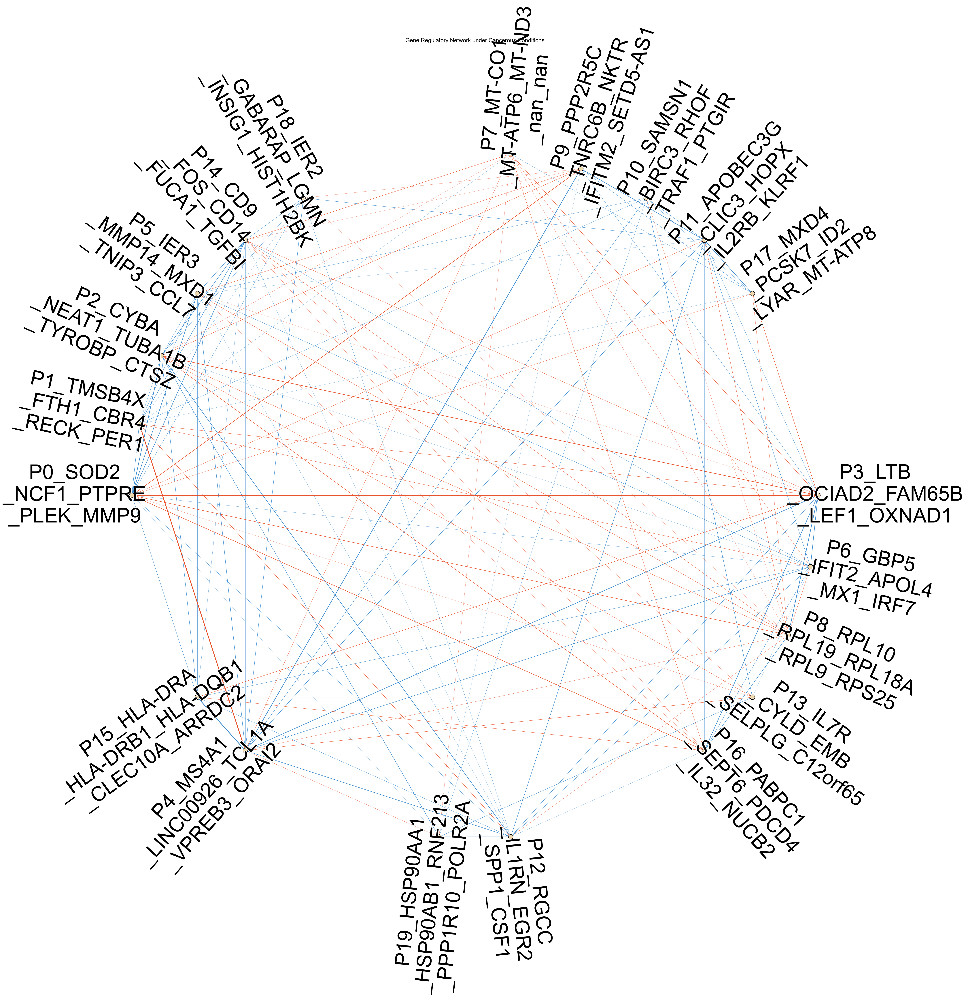

In [92]:
j_mat = model2.network
gene_programs = temporary_spin_name('test_signalling_0924/gene_programs_0_20_20.csv')
gene_program_names = [format_label(gene_program) for gene_program in gene_programs]
plot_final(gene_program_names, j_mat, spin_order2)

## Test Case for Number of Spin = 30

In [60]:
num_spin = 30
model3 = DSPIN(cadata, save_path, num_spin=num_spin)

496 genes have expression in more than 0.02 of the cells
LargeDSPIN initialized.


In [61]:
model3.gene_program_discovery(balance_obs='leiden')

Computing ONMF decomposition...


Iteration Progress: 100%|██████████| 100/100 [00:06<00:00, 14.48it/s, Reconstruction Error=2604.53]


In [62]:
model3.network_infer(sample_col_name='sample_id', example_list=subset_list)

Using pseudo_likelihood for network inference.
Progress: 5, Network gradient: 3.163259
Progress: 10, Network gradient: 1.763879
Progress: 15, Network gradient: 1.088827
Progress: 20, Network gradient: 0.653958
Progress: 25, Network gradient: 0.408201
Progress: 30, Network gradient: 0.268696
Progress: 35, Network gradient: 0.171940
Progress: 40, Network gradient: 0.127525
Progress: 45, Network gradient: 0.089944
Progress: 50, Network gradient: 0.064260
Progress: 55, Network gradient: 0.049439
Progress: 60, Network gradient: 0.039259
Progress: 65, Network gradient: 0.031902
Progress: 70, Network gradient: 0.029080
Progress: 75, Network gradient: 0.022907
Progress: 80, Network gradient: 0.018163
Progress: 85, Network gradient: 0.015062
Progress: 90, Network gradient: 0.012615
Progress: 95, Network gradient: 0.010721
Progress: 100, Network gradient: 0.009189


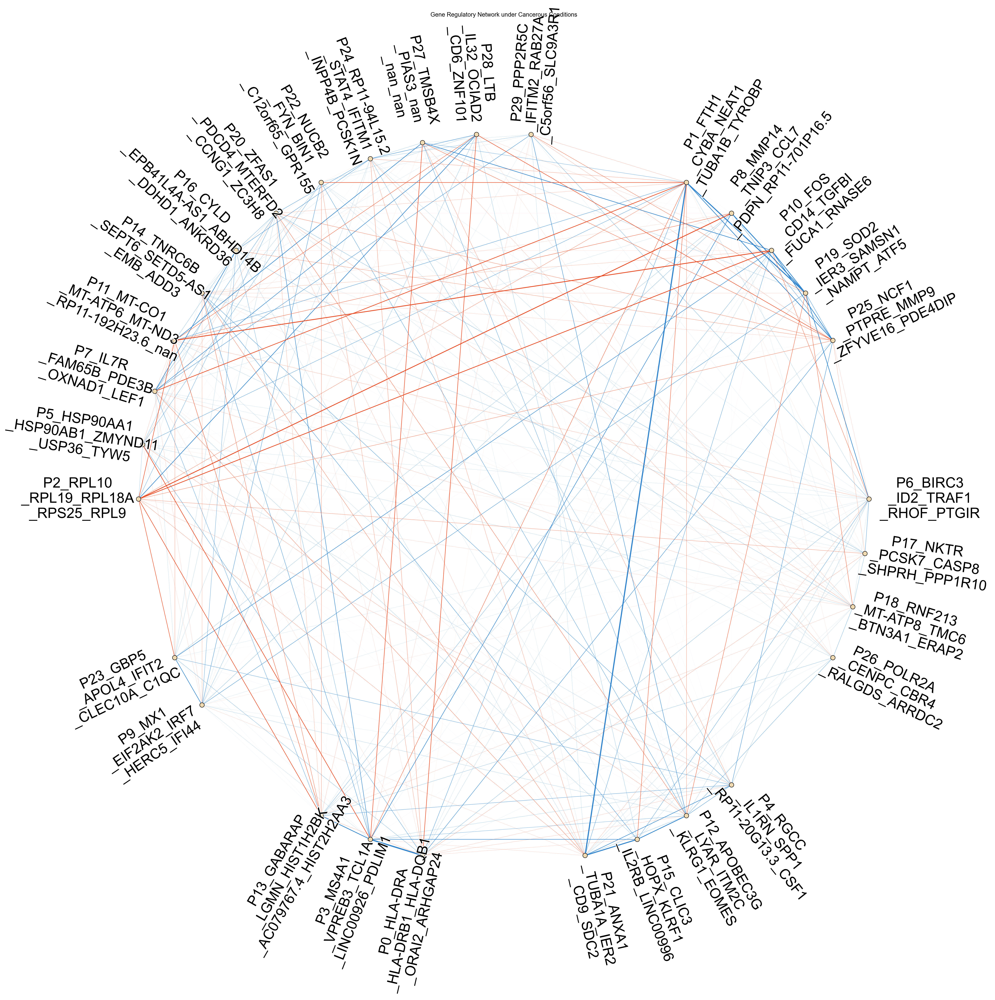

In [91]:
j_mat = model3.network
gene_programs = temporary_spin_name('test_signalling_0924/gene_programs_0_30_30.csv')
gene_program_names = [format_label(gene_program) for gene_program in gene_programs]
plot_final(gene_program_names, j_mat, spin_order3)

In [66]:
num_spin

30

## Test Case 4: 

In [69]:
num_spin = 30

model4 = DSPIN(cadata, save_path, num_spin=num_spin)

496 genes have expression in more than 0.02 of the cells
LargeDSPIN initialized.


In [75]:
prior_programs = ['FTH1 CYBA NEAT1 TUBA1B TYROBP CTSZ ATP6AP2'.split(' '), 'IL7R FAM65B PDE3B'.split(' '), 
                  'RPL10 RPL19 RPL18A RPS25 RPL9 RPL32 RPS27A RPL38 RPLP0 PABPC1 RPL31'.split(' ')] 

In [76]:
model4.gene_program_discovery(balance_obs='leiden', prior_programs=prior_programs)

Computing ONMF decomposition...


Iteration Progress:   1%|          | 1/100 [00:00<00:15,  6.38it/s, Reconstruction Error=2578.32]/Users/ygong/git/DSPIN-abstract/test/../util/compute_new.py:69: RuntimeWarning: invalid value encountered in divide
  coef_A = X.dot(S.T) / A.dot(S.dot(S.T))
Iteration Progress: 100%|██████████| 100/100 [00:03<00:00, 25.68it/s, Reconstruction Error=2388.37]


In [93]:
model4.network_infer(sample_col_name='sample_id', example_list=subset_list)

Using pseudo_likelihood for network inference.
Progress: 5, Network gradient: 3.145183
Progress: 10, Network gradient: 1.746163
Progress: 15, Network gradient: 1.085706
Progress: 20, Network gradient: 0.658214
Progress: 25, Network gradient: 0.415996
Progress: 30, Network gradient: 0.284332
Progress: 35, Network gradient: 0.197058
Progress: 40, Network gradient: 0.126466
Progress: 45, Network gradient: 0.089254
Progress: 50, Network gradient: 0.067738
Progress: 55, Network gradient: 0.052708
Progress: 60, Network gradient: 0.042911
Progress: 65, Network gradient: 0.036861
Progress: 70, Network gradient: 0.036161
Progress: 75, Network gradient: 0.028535
Progress: 80, Network gradient: 0.025048
Progress: 85, Network gradient: 0.022581
Progress: 90, Network gradient: 0.020596
Progress: 95, Network gradient: 0.018682
Progress: 100, Network gradient: 0.018150


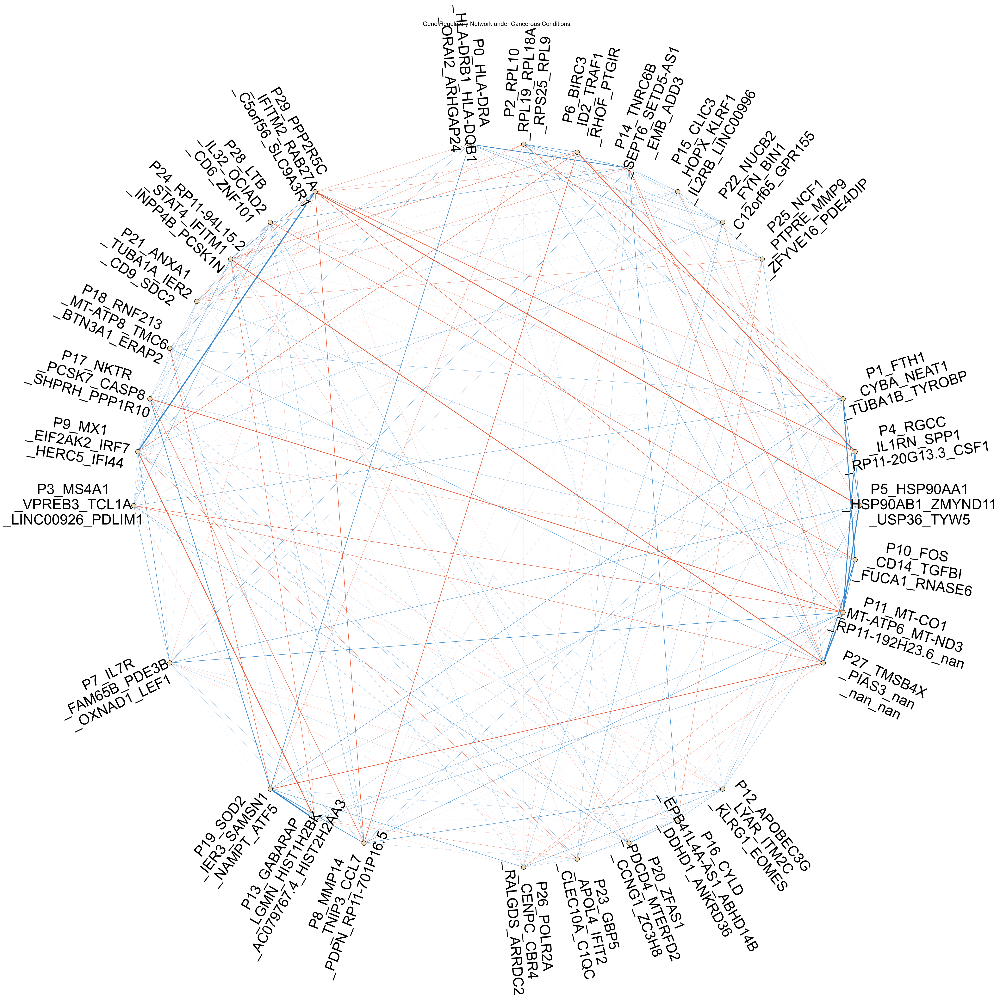

In [96]:
j_mat = model4.network
gene_programs = temporary_spin_name('test_signalling_0924/gene_programs_0_30_30.csv')
gene_program_names = [format_label(gene_program) for gene_program in gene_programs]
plot_final(gene_program_names, j_mat)

In [100]:
j_mat = model4.network
j_mat.shape

(30, 30)

## Test Case 5: HSC Simulation

In [97]:
data_folder = '../data/HSC_simulation/'
   
cadata = ad.read_h5ad(data_folder + 'hsc_simulation_with_perturbations_small.h5ad')

random_select = np.random.choice(cadata.shape[0], 10000, replace=False)
cadata = cadata[random_select, :].copy()

cadata.write(data_folder + 'hsc_simulation_with_perturbations_small.h5ad')

save_path = 'test/hsc_test0912'

samp_list = np.unique(cadata.obs['sample_id'])
subset_list = samp_list[: 3]

num_spin = cadata.shape[1]
model = DSPIN(cadata, save_path, num_spin=num_spin)

model.network_infer(sample_col_name='sample_id', example_list=subset_list)

11 genes have expression in more than 0.02 of the cells
Saving path does not exist. Creating a new folder.
SmallDSPIN initialized.
Using maximum_likelihood for network inference.
Progress: 5, Network gradient: 8.210810
Progress: 10, Network gradient: 3.982287
Progress: 15, Network gradient: 1.098703
Progress: 20, Network gradient: 1.097544
Progress: 25, Network gradient: 0.749718
Progress: 30, Network gradient: 0.580365
Progress: 35, Network gradient: 0.328236
Progress: 40, Network gradient: 0.186792
Progress: 45, Network gradient: 0.127431
Progress: 50, Network gradient: 0.103611
Progress: 55, Network gradient: 0.070965
Progress: 60, Network gradient: 0.054932
Progress: 65, Network gradient: 0.045826
Progress: 70, Network gradient: 0.038600
Progress: 75, Network gradient: 0.032800
Progress: 80, Network gradient: 0.027601
Progress: 85, Network gradient: 0.023670
Progress: 90, Network gradient: 0.020260
Progress: 95, Network gradient: 0.017339
Progress: 100, Network gradient: 0.014870


In [98]:
j_mat = model.network

In [99]:
j_mat.shape

(11, 11)